# Using SpatialTis with Jupyter notebook

This is a tutorial of SpatialTis, I will walk you through the essential part of the pacakge.

If you have a dataset can be processed on your own computer, using Jupyter environment for data analysis and visualization is pretty convenient.

## Data description

In this example I use MIBI dataset from this article:

[A Structured Tumor-Immune Microenvironment in Triple Negative Breast Cancer Revealed by Multiplexed Ion Beam Imaging](https://doi.org/10.1016/j.cell.2018.08.039)

**Download the data** for following analysis: [Link](https://uofmacau-my.sharepoint.com/:u:/g/personal/yb97643_umac_mo/ET7-chqWIc9EqSEtY-foQ7IBURusGw9hlTSBC3xD_bNdgw?download=1)

For origin data, follow their instruction in the article to request it. The processed data is placed at their [lab's page](https://www.angelolab.com/mibi-data). The data contains 41 patients, one ROI per patient.


The following example runs on an iMac 8-cores/40G RAM.

In [1]:
import numpy as np
import pandas as pd
import anndata as ad

In [2]:
import spatialtis as st
import spatialtis.plotting as sp
from spatialtis import CONFIG

First let's read the data, I have already processed their data into anndata object.

Because some of the background region are also marked as a cell in their mask images, we can filter out most of it based on area size.

In [3]:
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

In [4]:
data = ad.read_h5ad("../data/mibi_data.h5ad")
data = data[data.obs['area'] < 1000].copy()
data

AnnData object with n_obs × n_vars = 181376 × 39
    obs: 'Patient', 'area', 'cell_shape', 'centroid', 'eccentricity', 'cell_type'
    var: 'markers'

Before going into analysis, it would be convenient if we can set some global config first, so you don't need to pass the same argument into the functions every time.

You can overwrite global config with **local parameter**.

In [5]:
CONFIG.EXP_OBS = ['Patient'] # how the experiment design
CONFIG.CELL_TYPE_KEY = "cell_type" # The key that store cell type info in anndata.obs
CONFIG.MARKER_KEY = "markers" # The key that store marker info in anndata.var
CONFIG.MULTI_PROCESSING = True # turn on multiprocessing
CONFIG.WORKING_ENV = "jupyter_notebook"

You can list the current configuration of SpatialTis, but this is not everything, refer to the documentation for more configuration

In [6]:
CONFIG

## Visualization of ROI

If you have cell shape data, you can visualiza certain ROI, select the cells to highlight

Click the legend to mute certain cell type

In [7]:
sp.cell_map(data, {'Patient':'Patient 1'}, size=(500, 800))

In [8]:
sp.cell_map(data, {'Patient':'Patient 1'}, geom="point", size=(500, 800))

Visualization of marker expression in an ROI is also avaialble.

In [9]:
sp.expression_map(data, {'Patient':'Patient 1'}, order=['CD4', 'CD8', 'CD20'], size=(650, 600))

In [10]:
sp.expression_map(data, {'Patient':'Patient 1'}, use="scatter", order=['CD4', 'CD8', 'CD20'], size=(650, 650))

## Basic Statistic of spatial single cell data

- Cell components
- Cell density
- Cell morphology (eg. area, eccentricity...)
- Cell co-occurrence

### Cell components

This is to count the fraction of each cell type in different group

In [11]:
st.cell_components(data)

To visualize the every analysis results, there is always a plotting function with same name as the analysis function.

For example: the plotting function for `st.cell_components` is `sp.cell_components`

In [12]:
immune_cells = ['Macrophages', 'Tregs', 'CD4 T', 'CD3 T', 'CD8 T', 'NK', 'B', 'Neutrophils', 'DC', 'DC/Mono']
sp.cell_components(data, ['Patient'], 
                   size=(400, 1000), 
                   selected_types=immune_cells, 
                   sort_type='Macrophages',
                   title="Immune Cells' Components",
                   xaxis_title="Patients", 
                   yaxis_title="Percentage of cells(%)",
                  )

### Cell density

This is to measure the density of cell in each ROI

In [13]:
st.cell_density(data, ratio=0.001)

The Keratin-positive tumor is obviously much denser than other cell

In [14]:
selected_cells = ['Macrophages', 'Tregs', 'CD4 T', 'CD3 T', 'CD8 T', 'NK', 'B', 'Neutrophils', 'DC', 'DC/Mono', 
               'Keratin-positive tumor', 'Tumor','Endothelial', 'Mesenchymal-like']
sp.cell_density(data,
                selected_types=selected_cells,
                size=(350, 500),
                title="Cell density in 41 TNBC patinets", 
                yaxis_title="Number of cells/mm^2",
                palette=['#fdae61',]
               )

### Cell morphology

This is to measure the area or the eccentricity of cells, the default is to use eccentricity. The value of eccentricity get more close to 1 means the shape of the cell is more close to a circle.

In [15]:
st.cell_morphology(data)

In [16]:
immune_cells = ['Macrophages', 'Tregs', 'CD4 T', 'CD3 T', 'CD8 T', 'NK', 'B', 'Neutrophils', 'DC', 'DC/Mono']
sp.cell_morphology(data, 
                   selected_types=immune_cells, 
                   size=(300, 400), 
                   title="Eccentricity of immune cells", 
                   yaxis_title="eccentricity",
                   palette=['#abdda4',]
                  )

### Cell co-occurrence

This is to measure the likelihood of two type of cells occur in the same ROI

In [17]:
st.cell_co_occurrence(data)

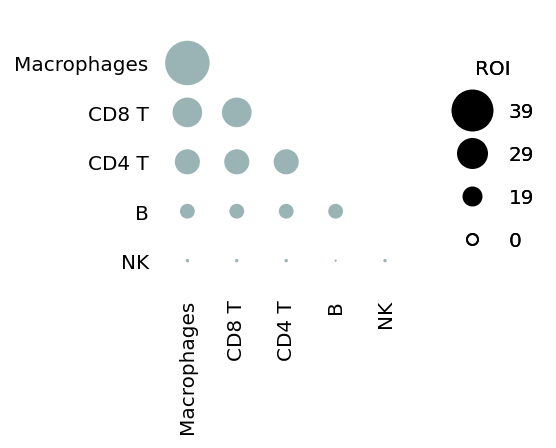

In [18]:
immune_cells = ['Macrophages', 'CD8 T', 'CD4 T', 'B', 'NK']
sp.cell_co_occurrence(data, ['Patient'], selected_types=immune_cells)

## Spatial analysis

- Spatial distribution
- Spatial heterogeneity
- Cell-cell interaction (Neighborhood analysis)
- Markers co-expression (Spatial enrichment analysis)
- Hotspot detection
- Spatial community detection
- Marker influenced by neighbor cells/markers

### Spatial distribution

The pattern of spatial distribution is `Random`, `Cluster`, `Regular`.

In [19]:
st.spatial_distribution(data)

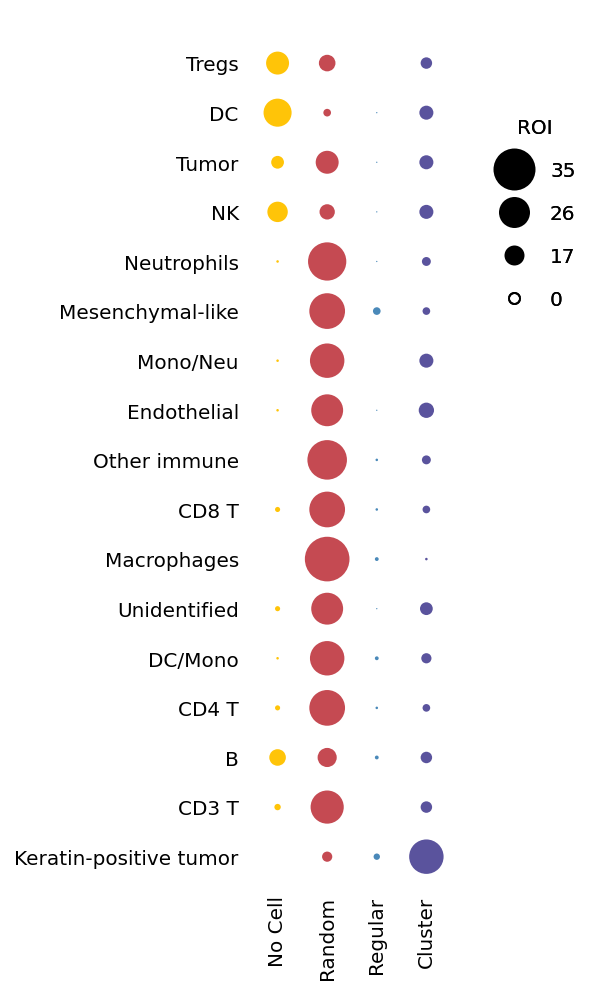

In [20]:
sp.spatial_distribution(data, use="dot")

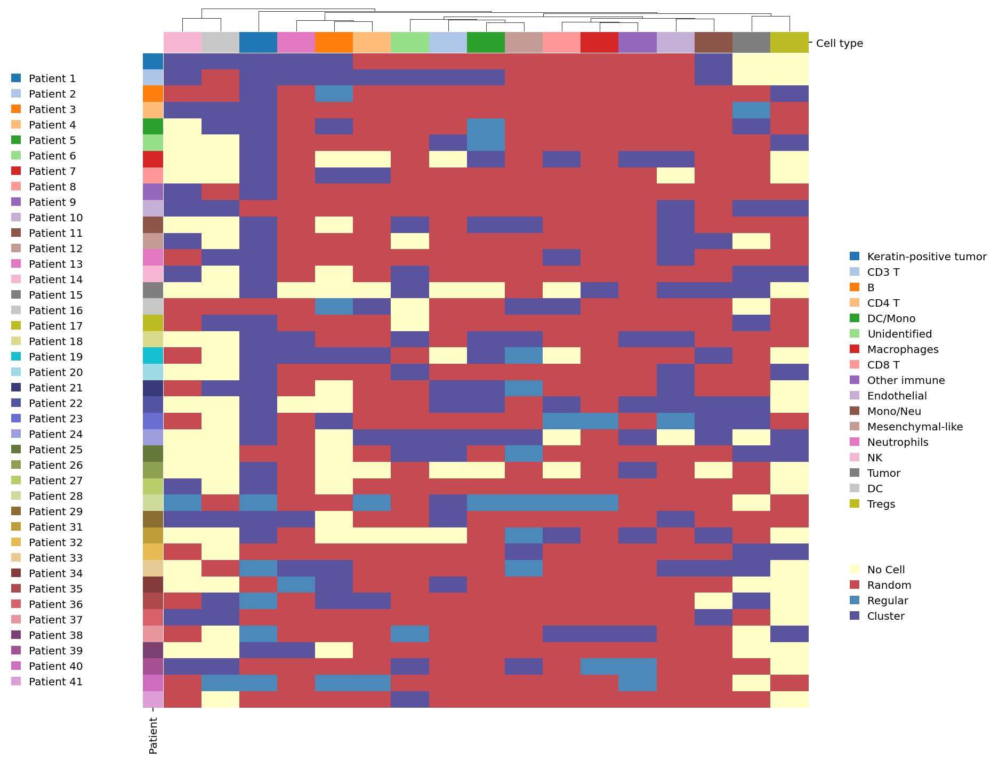

In [21]:
sns_heatmap_args = dict(method="ward")
sp.spatial_distribution(data, ['Patient'], use="heatmap", colorbar_bbox=(1.05, 0.1, 0.03, 0.15), **sns_heatmap_args)

### Spatial Heterogeneity

SpatialTis implemented 3 entropy based methods to quantify the heterogeneity

- Shannon entropy
- Altieri entropy
- Leibovici entropy

Check [spatialentropy](https://github.com/Mr-Milk/SpatialEntropy) if you are interested.

In [22]:
st.spatial_heterogeneity(data, method="altieri", cut=10)

In [23]:
sp.spatial_heterogeneity(data, size=(500, 1000))

### Finding cell neighbors

Intiate a `Neighbors` instance to find neighbors for each cells.

This MIBI dataset has cell shape data, we can search using default setting. For data resolved cell as point, pass `geom="point"`

In [24]:
n = st.Neighbors(data)

SpatialTis search the neighbors of a cell by enlarge the cell

`scale=1.5` will scale the cell at 1.5 fold (shape data)

`expand=5` will expand the cell by 5 unit (shape data, point data)

In [25]:
n.find_neighbors(expand=5)
n.export_neighbors()

A spatialtis.Neighbors instance, neighbor computed: True

You can also visualize the cell neighbors in any ROI

In [26]:
sp.cell_neighbors(data, {'Patient': 'Patient 1'})

### Neighborhood analysis

To profile the cell-cell relationship, neighborhood analysis tells you whether two type of cells are **association** or **avoidance**. 

Association means they are likely to occur at one's neighborhood

Avoidance means they tend to avoid to see one another

Neither means the relationship is random

Check [neighborhood_analysis](https://github.com/Mr-Milk/neighborhood_analysis) if you are interested.

<div class="alert alert-block alert-info">
Notice something is different in the parameter of the following analysis function, we pass in (n) a spatialtis.Neighbor instance instead of (data) a anndata object.
</div>

In [27]:
st.neighborhood_analysis(n, resample=999)

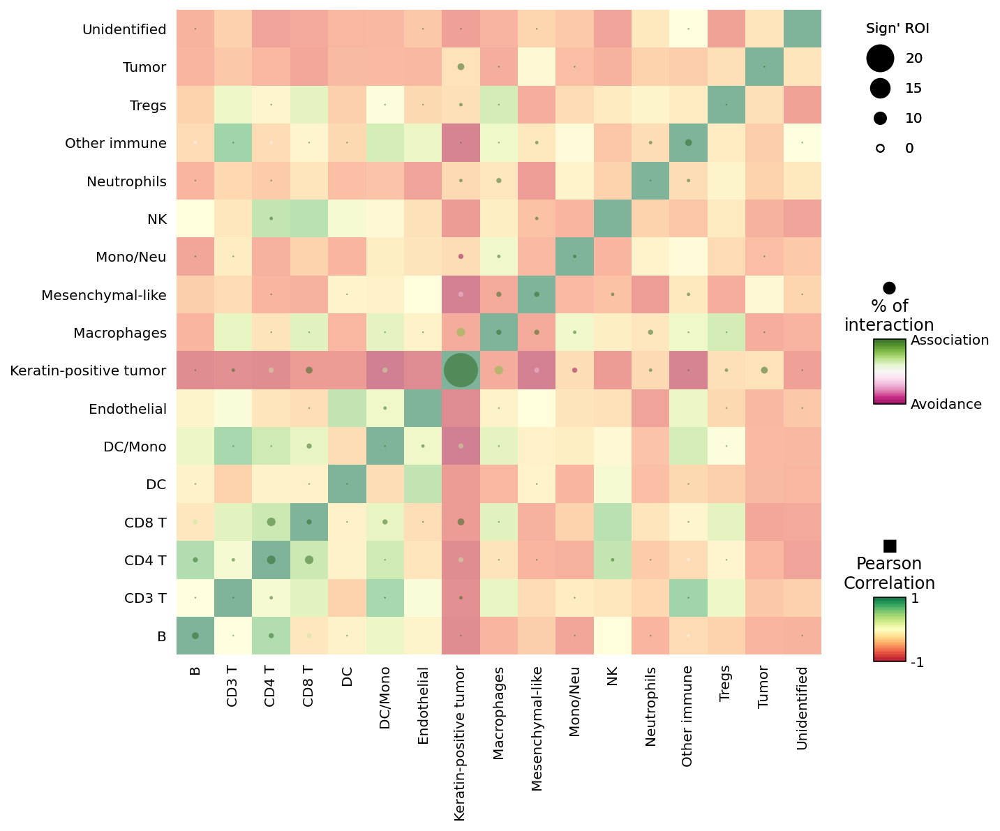

In [28]:
sp.neighborhood_analysis(data)

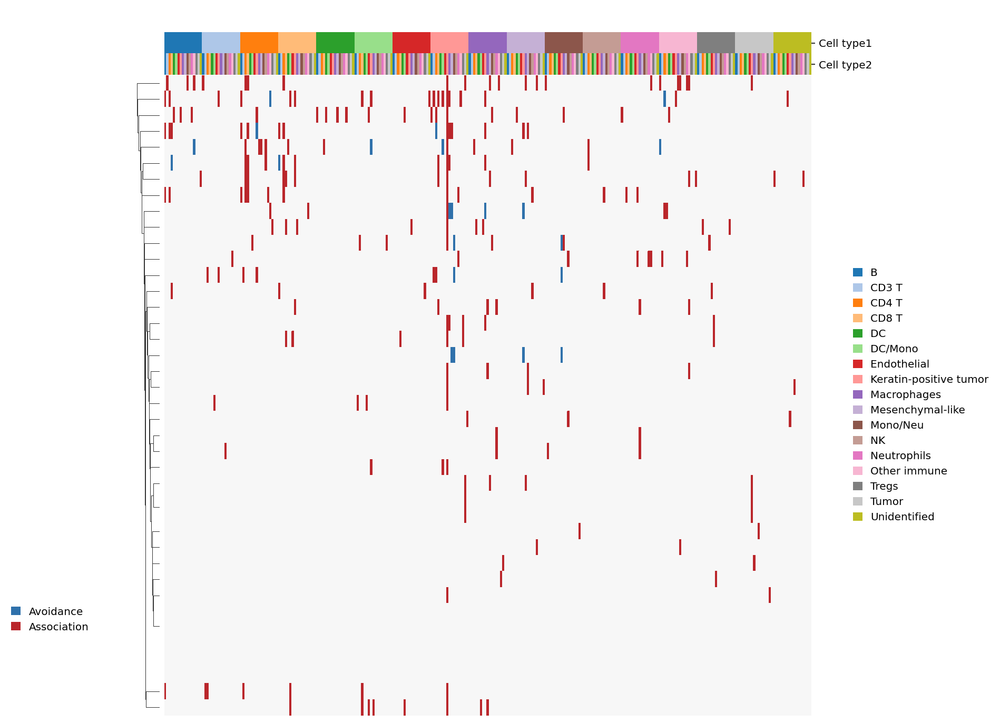

In [29]:
sp.neighborhood_analysis(data, use="heatmap")

### Spatial enrichment analysis

Profiling markers co-expression

In [30]:
st.spatial_enrichment_analysis(n, threshold=0.1, resample=500)

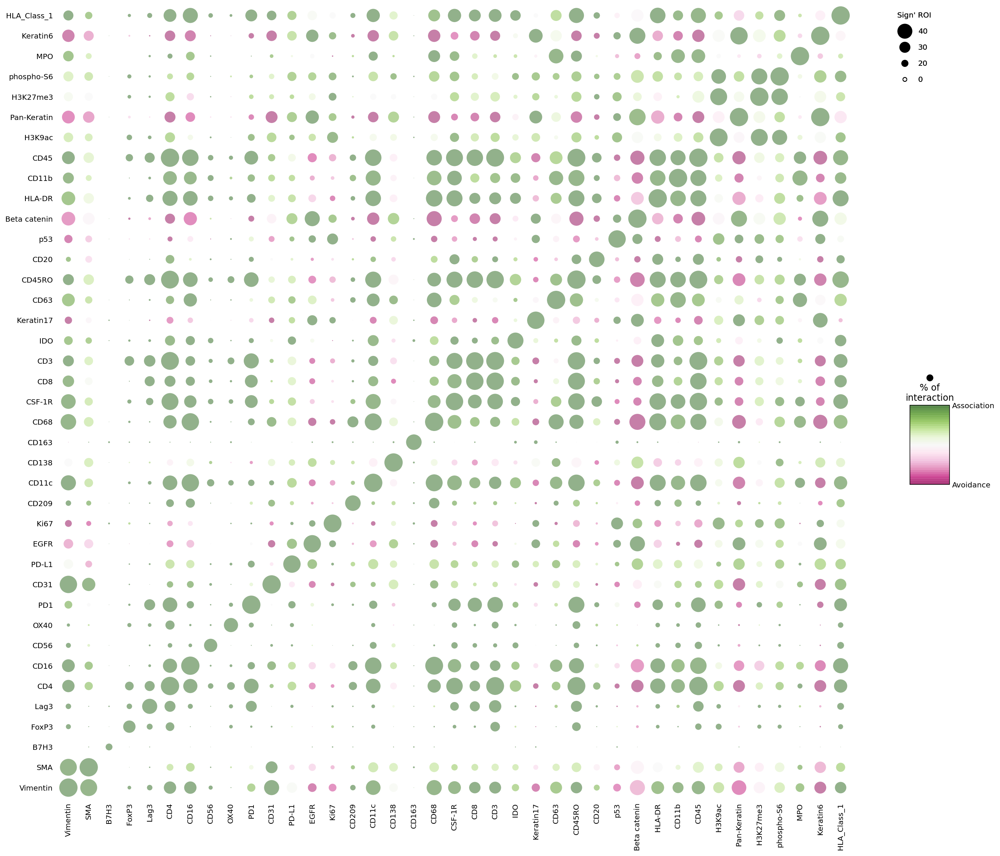

In [31]:
sp.spatial_enrichment_analysis(data)

### Cell communities detection

Leiden algorithm for communities detection

In [32]:
n.export_neighbors()
n.read_neighbors()

A spatialtis.Neighbors instance, neighbor computed: True

In [33]:
st.communities(n)

In [34]:
sp.cell_communities(data, {'Patient': 'Patient 1'})

### Neighbor cells dependent markers

<div class="alert alert-block alert-danger">
    
When processing your own data, you should use higher std threshold, i set a low value here only for illustration
     
</div>

In [35]:
st.NCD_markers(n, expression_std_cutoff=1.0)

The sankey plot is interpretated as: 

The **Cell 1**'s **Marker** is affected by the occurrence of **Cell 2** at it's neighbors

In [36]:
sp.NCD_markers(data, score=0.2)

### Neighbor markers dependent markers

In [37]:
st.NMD_markers(n, expression_std_cutoff=1.0)

Always remember to save your results by writing to the anndata file, otherwise it only store in the RAM

In [38]:
#data.write(data)

## Get SpatialTis's analysis result

You can read SpatialTis result in dataframe object for further analysis or visualization.

**Method 1**: use argument `return_df=True`

In [39]:
result = st.cell_components(data, return_df=True)

**Method 2**: read from the anndata.uns, if you know the key that store the SpatialTis's results

In [40]:
result = st.adata_uns2df(data, "exp_neighcell")

KeyError: 'exp_neighcell'

In [ ]:
result.head(5)